In [95]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
df = pd.read_csv(r'C:\Train.csv')
print(df)

     Item_Identifier  Item_Weight Item_Fat_Content  Item_Visibility  \
0              FDA15        9.300          Low Fat         0.016047   
1              DRC01        5.920          Regular         0.019278   
2              FDN15       17.500          Low Fat         0.016760   
3              FDX07       19.200          Regular         0.000000   
4              NCD19        8.930          Low Fat         0.000000   
5              FDP36       10.395          Regular         0.000000   
6              FDO10       13.650          Regular         0.012741   
7              FDP10          NaN          Low Fat         0.127470   
8              FDH17       16.200          Regular         0.016687   
9              FDU28       19.200          Regular         0.094450   
10             FDY07       11.800          Low Fat         0.000000   
11             FDA03       18.500          Regular         0.045464   
12             FDX32       15.100          Regular         0.100014   
13    

In [96]:
df.isnull()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,True,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False
5,False,False,False,False,False,False,False,False,False,False,False,False
6,False,False,False,False,False,False,False,False,False,False,False,False
7,False,True,False,False,False,False,False,False,False,False,False,False
8,False,False,False,False,False,False,False,False,True,False,False,False
9,False,False,False,False,False,False,False,False,True,False,False,False


In [97]:
rounded_values = []
for value in df['Item_Outlet_Sales']:
    rounded_values.append(round(value))  # Round and append to the list

# Update the DataFrame with the rounded values
df['Item_Outlet_Sales'] = rounded_values
df

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735
1,DRC01,5.920,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443
2,FDN15,17.500,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732
4,NCD19,8.930,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,995
5,FDP36,10.395,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,557
6,FDO10,13.650,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,344
7,FDP10,NaN,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4023
8,FDH17,16.200,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,NaN,Tier 2,Supermarket Type1,1077
9,FDU28,19.200,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,NaN,Tier 2,Supermarket Type1,4711


In [98]:
df.isnull().sum()

Item_Identifier                 0
Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64

Text(0, 0.5, 'Null percentage')

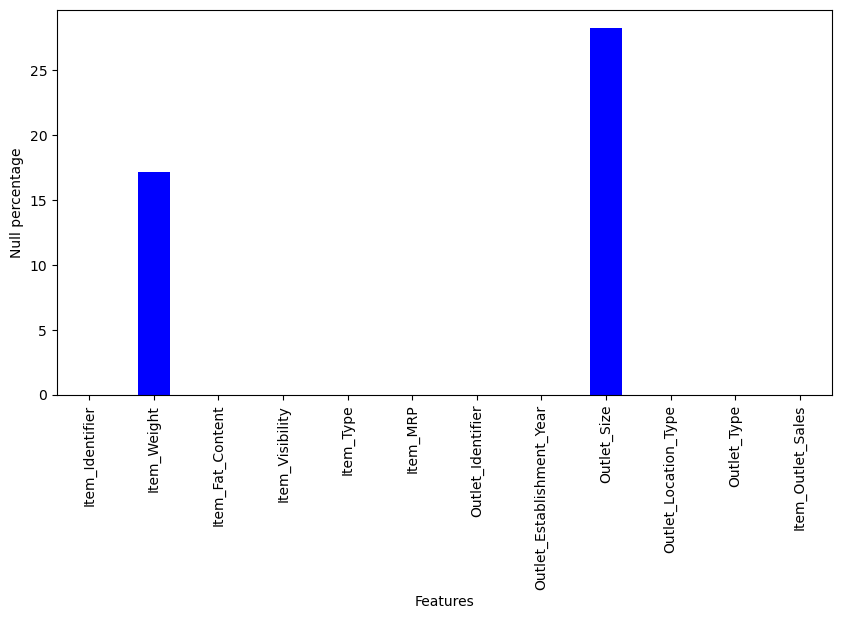

In [99]:
import matplotlib.pyplot as plt
null_percent = df.isnull().mean() * 100
plt.figure(figsize = (10, 5))
null_percent.plot(kind = 'bar', color = 'blue')
plt.xlabel('Features')
plt.ylabel('Null percentage')

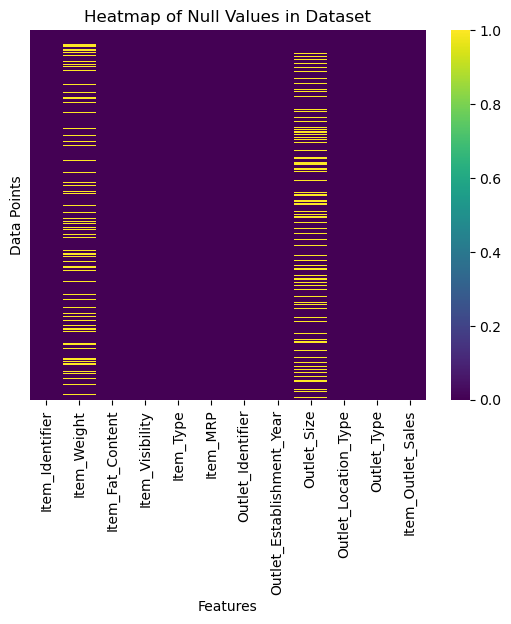

In [100]:
import seaborn as sns
sns.heatmap(df.isnull(), cbar=True, cmap='viridis', yticklabels=False)
plt.title('Heatmap of Null Values in Dataset')
plt.xlabel('Features')
plt.ylabel('Data Points')
plt.show()

In [101]:
columns_with_missing_data = df.columns[df.isnull().any()].tolist()
print(columns_with_missing_data)


['Item_Weight', 'Outlet_Size']


In [102]:
df['Item_Weight'].fillna(df['Item_Weight'].mean(), inplace = True)
df = df.drop('Outlet_Size', axis = 1)
df
# df['Outlet_Size'].fillna('medium', inplace=True)
# columns_with_missing_data = df.columns[df.isnull().any()].tolist()
# print(columns_with_missing_data)

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300000,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Tier 1,Supermarket Type1,3735
1,DRC01,5.920000,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Tier 3,Supermarket Type2,443
2,FDN15,17.500000,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Tier 1,Supermarket Type1,2097
3,FDX07,19.200000,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,Tier 3,Grocery Store,732
4,NCD19,8.930000,Low Fat,0.000000,Household,53.8614,OUT013,1987,Tier 3,Supermarket Type1,995
5,FDP36,10.395000,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Tier 3,Supermarket Type2,557
6,FDO10,13.650000,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,Tier 3,Supermarket Type1,344
7,FDP10,12.857645,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Tier 3,Supermarket Type3,4023
8,FDH17,16.200000,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,Tier 2,Supermarket Type1,1077
9,FDU28,19.200000,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,Tier 2,Supermarket Type1,4711


In [103]:
df.nunique()

Item_Identifier              1559
Item_Weight                   416
Item_Fat_Content                5
Item_Visibility              7880
Item_Type                      16
Item_MRP                     5938
Outlet_Identifier              10
Outlet_Establishment_Year       9
Outlet_Location_Type            3
Outlet_Type                     4
Item_Outlet_Sales            3069
dtype: int64

In [104]:
dataset = df.copy()  # Make a copy of df to avoid modifying the original DataFrame
dataset.columns = df.columns  # Set the column names
print(dataset.columns)

Index(['Item_Identifier', 'Item_Weight', 'Item_Fat_Content', 'Item_Visibility',
       'Item_Type', 'Item_MRP', 'Outlet_Identifier',
       'Outlet_Establishment_Year', 'Outlet_Location_Type', 'Outlet_Type',
       'Item_Outlet_Sales'],
      dtype='object')


In [105]:
df = df.drop(columns = ['Item_Identifier', 'Item_Visibility'], axis = 1)
df

,Item_Weight,Item_Fat_Content,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,9.300000,Low Fat,Dairy,249.8092,OUT049,1999,Tier 1,Supermarket Type1,3735
1,5.920000,Regular,Soft Drinks,48.2692,OUT018,2009,Tier 3,Supermarket Type2,443
2,17.500000,Low Fat,Meat,141.6180,OUT049,1999,Tier 1,Supermarket Type1,2097
3,19.200000,Regular,Fruits and Vegetables,182.0950,OUT010,1998,Tier 3,Grocery Store,732
4,8.930000,Low Fat,Household,53.8614,OUT013,1987,Tier 3,Supermarket Type1,995
5,10.395000,Regular,Baking Goods,51.4008,OUT018,2009,Tier 3,Supermarket Type2,557
6,13.650000,Regular,Snack Foods,57.6588,OUT013,1987,Tier 3,Supermarket Type1,344
7,12.857645,Low Fat,Snack Foods,107.7622,OUT027,1985,Tier 3,Supermarket Type3,4023
8,16.200000,Regular,Frozen Foods,96.9726,OUT045,2002,Tier 2,Supermarket Type1,1077
9,19.200000,Regular,Frozen Foods,187.8214,OUT017,2007,Tier 2,Supermarket Type1,4711


In [106]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
columns_encode = ['Item_Fat_Content', 'Item_Type', 'Outlet_Identifier', 'Outlet_Location_Type', 'Outlet_Type']

for column in columns_encode:
    df[column] = label_encoder.fit_transform(df[column])
print(df)

      Item_Weight  Item_Fat_Content  Item_Type  Item_MRP  Outlet_Identifier  \
0        9.300000                 1          4  249.8092                  9   
1        5.920000                 2         14   48.2692                  3   
2       17.500000                 1         10  141.6180                  9   
3       19.200000                 2          6  182.0950                  0   
4        8.930000                 1          9   53.8614                  1   
5       10.395000                 2          0   51.4008                  3   
6       13.650000                 2         13   57.6588                  1   
7       12.857645                 1         13  107.7622                  5   
8       16.200000                 2          5   96.9726                  7   
9       19.200000                 2          5  187.8214                  2   
10      11.800000                 1          6   45.5402                  9   
11      18.500000                 2          4  144.

In [107]:
pd.set_option('display.max_rows', None)  # None means no limit
pd.set_option('display.max_columns', None)
print(df)

      Item_Weight  Item_Fat_Content  Item_Type  Item_MRP  Outlet_Identifier  \
0        9.300000                 1          4  249.8092                  9   
1        5.920000                 2         14   48.2692                  3   
2       17.500000                 1         10  141.6180                  9   
3       19.200000                 2          6  182.0950                  0   
4        8.930000                 1          9   53.8614                  1   
5       10.395000                 2          0   51.4008                  3   
6       13.650000                 2         13   57.6588                  1   
7       12.857645                 1         13  107.7622                  5   
8       16.200000                 2          5   96.9726                  7   
9       19.200000                 2          5  187.8214                  2   
10      11.800000                 1          6   45.5402                  9   
11      18.500000                 2          4  144.

In [108]:
df_train = df[0:7500]
df_test = df[7500:]

In [109]:
X = df_train.drop('Item_Outlet_Sales', axis = 1)
Y = df_train.Item_Outlet_Sales
Y

0        3735
1         443
2        2097
3         732
4         995
5         557
6         344
7        4023
8        1077
9        4711
10       1516
11       2187
12       1589
13       2145
14       1977
15       1547
16       1622
17        718
18       2304
19       2748
20       3775
21       4064
22       1587
23        214
24       4078
25        839
26       1065
27        309
28        178
29        126
30        164
31       2742
32       3068
33       2175
34       2085
35       3791
36       2798
37       1610
38        388
39       2180
40       3436
41       2151
42       2527
43       6769
44        374
45        358
46       2429
47       5815
48       2577
49        780
50       3135
51        851
52        811
53       3121
54       4815
55       6259
56       2117
57        797
58       4910
59        892
60       3185
61       1063
62        485
63        148
64       2543
65        184
66       4866
67       1119
68       2302
69       2027
70       3436
71    

In [110]:
from sklearn.linear_model import Lasso
from sklearn.feature_selection import SelectFromModel

In [111]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.30, random_state = 42)
# from sklearn.preprocessing import StandardScaler
# scaler = StandardScaler()
# X_train = scaler.fit_transform(X_train)
# X_test = scaler.transform(X_test)

In [112]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [113]:
model = SelectFromModel(Lasso(alpha = 0.005, random_state = 0))

In [114]:
model.fit(X_train, Y_train)

SelectFromModel(estimator=Lasso(alpha=0.005, random_state=0))

In [115]:
from sklearn.linear_model import LinearRegression
import numpy as np
from sklearn.model_selection import cross_val_score
linear_regressor = LinearRegression()
linear_regressor.fit(X_train, Y_train)
mse = cross_val_score(linear_regressor, X_train, Y_train, scoring = 'neg_mean_squared_error', cv = 10)
np.mean(mse)


-1461798.9123393374

C:\Users\Ishan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


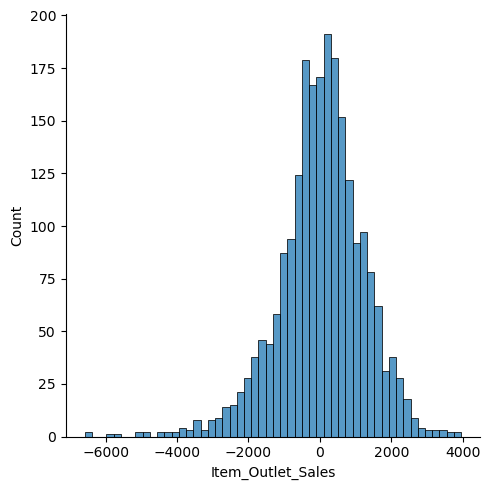

In [116]:
reg_pred = linear_regressor.predict(X_test)
import seaborn as sns
sns.displot(reg_pred - Y_test)

In [118]:
from sklearn.metrics import r2_score
score = r2_score(reg_pred, Y_test)
print(score)

-0.003138763569082492


In [119]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV
ridge_regressor = Ridge()
parameter = {'alpha' : [1,2,3,4,5,10,20,30,40,50,60,70,80,90]}
ridgecv = GridSearchCV(ridge_regressor, parameter, scoring = 'neg_mean_squared_error', cv = 10)
ridgecv.fit(X_train, Y_train)
print(ridgecv.best_params_)
print(ridgecv.best_score_)

{'alpha': 5}
-1461796.6933107933


C:\Users\Ishan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


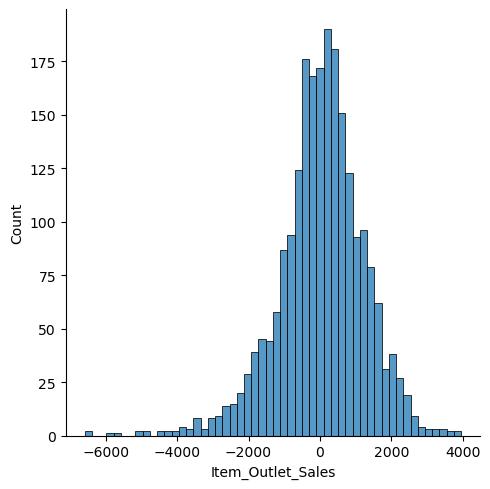

In [120]:
ridge_pred = ridgecv.predict(X_test)
import seaborn as sns
sns.displot(ridge_pred - Y_test)

In [128]:
from sklearn.metrics import r2_score
score = r2_score(reg_pred, Y_test)
print(score)

-0.003138763569082492


In [129]:
from sklearn.model_selection import RandomizedSearchCV
import numpy as np
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 800, num = 8)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(5, 20, num = 6)]
min_samples_split = [2, 5, 10, 15]
min_samples_leaf = [1, 2, 5, 10]

In [130]:
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

print(random_grid)

{'n_estimators': [100, 200, 300, 400, 500, 600, 700, 800], 'max_features': ['auto', 'sqrt'], 'max_depth': [5, 8, 11, 14, 17, 20], 'min_samples_split': [2, 5, 10, 15], 'min_samples_leaf': [1, 2, 5, 10]}


In [131]:
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor()

In [132]:
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid,scoring='neg_mean_squared_error', n_iter = 50, cv = 5, verbose=2, random_state=42, n_jobs = 1)

In [133]:
rf_random.fit(X_train,Y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=   8.5s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=   8.4s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=   8.1s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=   9.0s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=   8.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=500; total time=   3.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=500; total time=   3.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=500; total time=   3.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=500; total time=   3.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=500; total time=   3.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=500; total time=   5.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=500; total time=   5.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=500; total time=   5.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=500; total time=   5.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=500; total time=   5.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=   1.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=   1.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=   2.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=   2.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=   1.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=600; total time=   8.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=600; total time=   8.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=600; total time=   8.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=600; total time=   9.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=600; total time=   8.9s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=500; total time=   3.8s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=500; total time=   3.1s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=500; total time=   3.4s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=500; total time=   3.2s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=500; total time=   3.6s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=10, min_samples_split=10, n_estimators=600; total time=   3.0s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=10, min_samples_split=10, n_estimators=600; total time=   4.6s
[CV] END max_depth=11, max_feat

C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  18.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  14.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  12.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  15.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  15.3s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=700; total time=   4.6s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=700; total time=   5.6s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=700; total time=   5.4s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=700; total time=   5.6s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=700; total time=   5.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=10, n_estimators=400; total time=   3.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=10, n_estimators=400; total time=   4.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=10, n_estimators=400; total time=   3.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=10, n_estimators=400; total time=   3.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=10, n_estimators=400; total time=   3.9s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=800; total time=   5.7s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=800; total time=   5.7s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=800; total time=   5.4s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=800; total time=   4.5s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=800; total time=   4.7s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   6.1s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   7.5s
[CV] END max_depth=17, max_features=sqr

C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=700; total time=   6.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=700; total time=   6.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=700; total time=   5.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=700; total time=   6.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=700; total time=   6.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=200; total time=   2.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=200; total time=   2.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=200; total time=   2.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=200; total time=   2.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=200; total time=   2.6s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=10, n_estimators=100; total time=   0.4s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=10, n_estimators=100; total time=   0.5s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=10, n_estimators=100; total time=   0.4s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=10, n_estimators=100; total time=   0.4s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=10, n_estimators=100; total time=   0.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=600; total time=  10.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=600; total time=   9.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=600; total time=  10.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=600; total time=   8.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=600; total time=   8.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=200; total time=   2.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=200; total time=   2.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=200; total time=   3.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=200; total time=   3.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=200; total time=   3.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   5.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   6.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   7.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   5.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   5.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=600; total time=   8.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=600; total time=   7.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=600; total time=   8.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=600; total time=   8.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=600; total time=   9.0s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=15, n_estimators=700; total time=   5.0s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=15, n_estimators=700; total time=   4.7s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=15, n_estimators=700; total time=   5.7s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=15, n_estimators=700; total time=   4.8s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=15, n_estimators=700; total time=   5.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=2, n_estimators=700; total time=   9.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=2, n_estimators=700; total time=   7.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=2, n_estimators=700; total time=   8.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=2, n_estimators=700; total time=   7.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=2, n_estimators=700; total time=   7.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=  10.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=  11.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=  10.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=   8.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=  10.1s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, n_estimators=100; total time=   0.6s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, n_estimators=100; total time=   0.6s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, n_estimators=100; total time=   0.6s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, n_estimators=100; total time=   0.6s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, n_estimators=100; total time=   0.6s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time=   5.2s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time=   5.7s
[CV] END max_depth=14, max_features=sqr

C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=300; total time=   5.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=300; total time=   5.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=300; total time=   5.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=300; total time=   5.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=300; total time=   5.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   9.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=  11.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   9.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   7.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=15, n_estimators=500; total time=   7.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  13.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  12.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  13.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  13.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=800; total time=  12.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=200; total time=   3.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=200; total time=   3.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=200; total time=   3.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=200; total time=   3.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=5, n_estimators=200; total time=   3.1s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=400; total time=   2.8s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=400; total time=   2.8s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=400; total time=   3.2s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=400; total time=   2.9s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=400; total time=   2.8s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=700; total time=   6.7s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=700; total time=   6.0s
[CV] END max_depth=17, max_features=sq

C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   9.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   9.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   8.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   9.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   8.9s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=600; total time=   4.1s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=600; total time=   4.0s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=600; total time=   4.0s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=600; total time=   4.2s
[CV] END max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=15, n_estimators=600; total time=   5.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=300; total time=   9.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=300; total time=   5.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=300; total time=   5.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=300; total time=   5.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=300; total time=   5.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=200; total time=   4.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=200; total time=   4.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=200; total time=   3.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=200; total time=   3.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=15, n_estimators=200; total time=   4.2s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=700; total time=   6.6s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=700; total time=   6.6s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=700; total time=   6.6s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=700; total time=   6.7s
[CV] END max_depth=17, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=700; total time=   6.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   2.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   2.0s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   1.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   2.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=17, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   1.8s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=   8.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=   9.3s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=   8.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=   8.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=600; total time=   8.5s
[CV] END max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   3.2s
[CV] END max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   3.0s
[CV] END max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   3.0s
[CV] END max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   3.1s
[CV] END max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, n_estimators=600; total time=   3.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=300; total time=   3.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=300; total time=   3.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=300; total time=   3.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=300; total time=   3.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, n_estimators=300; total time=   3.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   7.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   7.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   7.7s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   7.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   8.2s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=400; total time=   3.5s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=400; total time=   3.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=400; total time=   3.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=400; total time=   4.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=15, n_estimators=400; total time=   3.4s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=10, n_estimators=600; total time=   9.9s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=10, n_estimators=600; total time=   9.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=10, n_estimators=600; total time=   9.1s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=10, n_estimators=600; total time=   9.6s


C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=10, n_estimators=600; total time=   9.8s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   0.7s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   0.6s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   0.6s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   0.6s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=15, n_estimators=100; total time=   0.6s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=10, n_estimators=300; total time=   2.0s
[CV] END max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=10, n_estimators=300; total time=   2.1s
[CV] END max_depth=14, max_featu

C:\Users\Ishan\anaconda3\Lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=50, n_jobs=1,
                   param_distributions={'max_depth': [5, 8, 11, 14, 17, 20],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 5, 10],
                                        'min_samples_split': [2, 5, 10, 15],
                                        'n_estimators': [100, 200, 300, 400,
                                                         500, 600, 700, 800]},
                   random_state=42, scoring='neg_mean_squared_error',
                   verbose=2)

In [76]:
y_pred=rf_random.predict(X_test)

C:\Users\Ishan\AppData\Local\Temp\ipykernel_8664\1080903.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_test-y_pred)
C:\Users\Ishan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


<Axes: xlabel='Item_Outlet_Sales', ylabel='Density'>

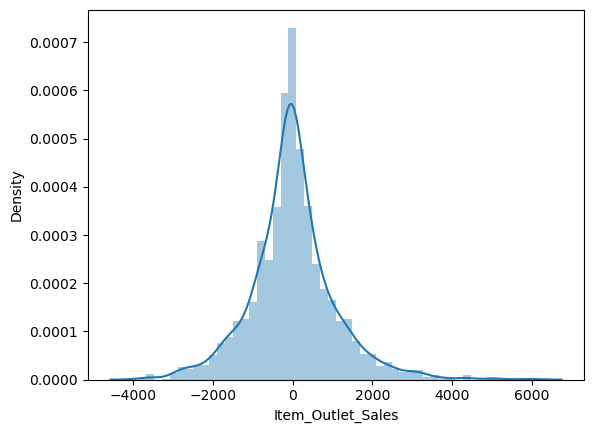

In [77]:
import seaborn as sns

sns.distplot(Y_test-y_pred)

In [78]:
from sklearn.metrics import r2_score
score = r2_score(Y_test, y_pred)
print(score)

0.5976072707171363


In [142]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Initialize the Gradient Boosting Regressor model
XG_regressor = GradientBoostingRegressor(learning_rate = 0.1)

# Train the model on the training data
XG_regressor.fit(X_train, Y_train)

# Make predictions using the correct model (XG_regressor)
y_pred = XG_regressor.predict(X_test)

# Evaluate the model's performance using Mean Squared Error (MSE) and R-squared (R2)
mse = mean_squared_error(Y_test, y_pred)
r2 = r2_score(Y_test, y_pred)

# Print the R-squared value
print(r2)

0.5947672317016186


In [86]:
from sklearn.svm import SVR
svr = SVR(kernel='linear')  # You can also use 'linear', 'poly', or 'sigmoid' kernels
svr.fit(X_train, Y_train)

# Making predictions
y_pred = svr.predict(X_test)
mse = mean_squared_error(Y_test, y_pred)
r2 = r2_score(Y_test, y_pred)
print(r2)

0.45464522240627814


In [89]:
from sklearn.linear_model import ElasticNet
elastic_model = ElasticNet(alpha=1.0, l1_ratio=0.5, fit_intercept=True, precompute=False, max_iter=1000, random_state = 42)
elastic_model.fit(X_train, Y_train)

# Make predictions
# y_pred_train = elastic_net_model.predict(X_train)
y_pred_test = elastic_model.predict(X_test)
test_r2 = r2_score(Y_test, y_pred_test)
print(test_r2)

0.4428616097848391


In [145]:
from sklearn.tree import DecisionTreeRegressor
decision_regressor = DecisionTreeRegressor(criterion='poisson', splitter='best', max_depth=None, min_samples_split=2, min_samples_leaf=1, random_state = 42)
decision_regressor.fit(X_train, Y_train)

# Make predictions
# y_pred_train = decision_tree_model.predict(X_train)
y_pred_test = decision_regressor.predict(X_test)

# Evaluate the model performance

test_r2_decision = r2_score(Y_test, y_pred_test)
print(test_r2_decision)

0.1937600953059524
